# Machine Learning (Modeling) Part 2

## Importing Libraries

In [162]:
%matplotlib inline
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
import re
import string
import random
import contractions
import datetime
import joblib

import tensorflow as tf
from tensorflow.keras import layers
from tensorflow import keras
from tensorflow.python.client import device_lib
from keras.models import Model
from keras.layers import LSTM, Dense, Flatten, Dropout, Input, Embedding, Bidirectional, GlobalMaxPool1D, concatenate
from keras.regularizers import l2
from tensorflow.keras.optimizers import RMSprop
from keras.preprocessing.sequence import pad_sequences
from keras.preprocessing.text import Tokenizer
from keras.preprocessing import sequence
from keras.callbacks import EarlyStopping
from keras.models import load_model
from plot_keras_history import plot_history

from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

from sklearn.preprocessing import LabelEncoder, OrdinalEncoder, MinMaxScaler
from imblearn.over_sampling import RandomOverSampler, SMOTE
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix

In [2]:
# Set the maximum number of columns to display
pd.set_option('display.max_colwidth', 100)
pd.set_option("display.max_columns", 100)

## Test the GPU for Tensorflow

When using tensorflow with gpu, it is extremely important to perform the test codes to verify if the environment can detect the GPU smoothly or not.

In [3]:
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

Num GPUs Available:  1


In [4]:
tf.test.is_built_with_cuda()

True

In [5]:
print(tf.version.VERSION)

2.5.0


In [6]:
# The 2nd device must show device type of GPU
print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 11543632789980226728
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 1970549556
locality {
  bus_id: 1
  links {
  }
}
incarnation: 678956033096969781
physical_device_desc: "device: 0, name: GeForce GTX 1060, pci bus id: 0000:01:00.0, compute capability: 6.1"
]


In [85]:
tf.config.run_functions_eagerly(True)
tf.data.experimental.enable_debug_mode()

# Import Data

We'll import the cleaned exported data instead of the raw data since we have saved it previously.

In [7]:
# Read the data into df
df = pd.read_csv("D:/Documents/Data Science Learning/My Project/Recruitment Scam/02-data/recruitment_cleaned.csv")

# Take a look at the first 10 rows of the dataset
df.head(10)

,title,location,company_profile,description,requirements,benefits,telecommuting,has_company_logo,has_questions,employment_type,required_experience,required_education,function,fraudulent,in_balanced_dataset,country,state
0,Marketing Intern,"US, NY, New York","<h3>We're Food52, and we've created a groundbreaking and award-winning cooking site. We support,...","<p>Food52, a fast-growing, James Beard Award-winning online food community and crowd-sourced and...",<ul>\r\n<li>Experience with content management systems a major plus (any blogging counts!)</li>\...,NaN,0,1,0,Other,Internship,Unspecified,Marketing,0,0,US,NY
1,Customer Service - Cloud Video Production,"NZ, , Auckland","<h3>90 Seconds, the worlds Cloud Video Production Service.</h3>\r\n<p>90 Seconds is the worlds C...",<p>Organised - Focused - Vibrant - Awesome!<br><br>Do you have a passion for customer service? S...,<p><b>What we expect from you:</b></p>\r\n<p>Your key responsibility will be to communicate with...,<h3><b>What you will get from us</b></h3>\r\n<p>Through being part of the 90 Seconds team you wi...,0,1,0,Full-time,Not Applicable,Unspecified,Customer Service,0,0,NZ,N
2,Commissioning Machinery Assistant (CMA),"US, IA, Wever",<h3></h3>\r\n<p>Valor Services provides Workforce Solutions that meet the needs of companies acr...,"<p>Our client, located in Houston, is actively seeking an experienced Commissioning Machinery As...",<ul>\r\n<li>Implement pre-commissioning and commissioning procedures for rotary equipment.</li>\...,NaN,0,1,0,Full-time,Mid-Senior level,Unspecified,Administrative,0,0,US,IA
3,Account Executive - Washington DC,"US, DC, Washington",<p>Our passion for improving quality of life through geography is at the heart of everything we ...,<p><b>THE COMPANY: ESRI – Environmental Systems Research Institute</b></p>\r\n<p>Our passion for...,"<ul>\r\n<li>\r\n<b>EDUCATION: </b>Bachelor’s or Master’s in GIS, business administration, or a r...","<p>Our culture is anything but corporate—we have a collaborative, creative environment; phone di...",0,1,0,Full-time,Mid-Senior level,Bachelor's Degree,Sales,0,0,US,DC
4,Bill Review Manager,"US, FL, Fort Worth",<p>SpotSource Solutions LLC is a Global Human Capital Management Consulting firm headquartered i...,"<p><b>JOB TITLE:</b> Itemization Review Manager</p>\r\n<p><b>LOCATION:</b> Fort Worth, TX<b> ...",<p><b>QUALIFICATIONS:</b></p>\r\n<ul>\r\n<li>RN license in the State of Texas</li>\r\n<li>Diplom...,<p>Full Benefits Offered</p>,0,1,1,Full-time,Mid-Senior level,Bachelor's Degree,Health Care Provider,0,0,US,FL
5,Accounting Clerk,"US, MD,",NaN,<p><b>Job Overview</b></p>\r\n<p>Apex is an environmental consulting firm that offers stable lea...,NaN,NaN,0,0,0,Full-time,Mid-Senior level,Bachelor's Degree,Administrative,0,0,US,MD
6,Head of Content (m/f),"DE, BE, Berlin","<p>Founded in 2009, the <b>Fonpit AG</b> rose with its international web portal <b>ANDROIDPIT</b...",<p><b>Your Responsibilities:</b></p>\r\n<p> </p>\r\n<ul>\r\n<li>Manage the English-speaking edit...,<p><b>Your Know-How:</b></p>\r\n<p><b> ...,<p><b>Your Benefits:</b></p>\r\n<p> </p>\r\n<ul>\r\n<li>Being part of a fast-growing company in ...,0,1,1,Full-time,Mid-Senior level,Master's Degree,Management,0,0,DE,BE
7,Lead Guest Service Specialist,"US, CA, San Francisco",<p>Airenvy’s mission is to provide lucrative yet hassle free full service short term property ma...,<h3>Who is Airenvy?</h3>\r\n<p>Hey there! We are seasoned entrepreneurs in the heart of San Fran...,"<ul>\r\n<li>Experience with CRM software, live chat, and phones, including one year minimum of c...",<p><b>Competitive Pay.</b> You'll be able to eat steak everyday if you choose to. </p>\r\n<p><b...,0,1,1,Full-time,Entry level,Unspecified,Management,0,0,US,CA
8,HP BSM SME,"US, FL, Pensacola",<p>Solutions3 is a <b>woman-owned small business </b>whose focus is IT Service Management using ...,<p></p>\r\n<p></p>\r\n<p>Implementation/Configuration/Testing/Training on:</p>\r\n<p>HP Service ...,<p><b>MU

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17645 entries, 0 to 17644
Data columns (total 17 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   title                17645 non-null  object
 1   location             17302 non-null  object
 2   company_profile      14358 non-null  object
 3   description          17645 non-null  object
 4   requirements         14995 non-null  object
 5   benefits             10542 non-null  object
 6   telecommuting        17645 non-null  int64 
 7   has_company_logo     17645 non-null  int64 
 8   has_questions        17645 non-null  int64 
 9   employment_type      17645 non-null  object
 10  required_experience  17645 non-null  object
 11  required_education   17645 non-null  object
 12  function             17645 non-null  object
 13  fraudulent           17645 non-null  int64 
 14  in_balanced_dataset  17645 non-null  int64 
 15  country              17645 non-null  object
 16  stat

In [9]:
df.shape

(17645, 17)

In [10]:
df['fraudulent'].value_counts()

0    16787
1      858
Name: fraudulent, dtype: int64

In [11]:
df.isnull().sum()

title                     0
location                343
company_profile        3287
description               0
requirements           2650
benefits               7103
telecommuting             0
has_company_logo          0
has_questions             0
employment_type           0
required_experience       0
required_education        0
function                  0
fraudulent                0
in_balanced_dataset       0
country                   0
state                  1234
dtype: int64

In [12]:
df.describe()

,telecommuting,has_company_logo,has_questions,fraudulent,in_balanced_dataset
count,17645.000000,17645.000000,17645.000000,17645.000000,17645.000000
mean,0.042845,0.794049,0.491697,0.048626,0.050666
std,0.202513,0.404406,0.499945,0.215090,0.219321
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,1.000000,0.000000,0.000000,0.000000
50%,0.000000,1.000000,0.000000,0.000000,0.000000
75%,0.000000,1.000000,1.000000,0.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000


# Initial Data Preparation

## Data Cleaning of Text Columns

In [13]:
df['location'] = df['location'].fillna('')
df['company_profile'] = df['company_profile'].fillna('')
df['requirements'] = df['requirements'].fillna('')
df['benefits'] = df['benefits'].fillna('')
df['state'] = df['state'].fillna('')

In [14]:
df.isnull().sum()

title                  0
location               0
company_profile        0
description            0
requirements           0
benefits               0
telecommuting          0
has_company_logo       0
has_questions          0
employment_type        0
required_experience    0
required_education     0
function               0
fraudulent             0
in_balanced_dataset    0
country                0
state                  0
dtype: int64

In [15]:
# Metadata df, excluding state
df_structured = df.copy()
df_structured = df_structured.iloc[:, 6:16]

# Text df
df_text = df.copy()
df_text = df_text.iloc[:, [0, 1, 2, 3, 4, 5, 13]]

In [16]:
df_structured.shape, df_text.shape

((17645, 10), (17645, 7))

In [17]:
df_structured.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17645 entries, 0 to 17644
Data columns (total 10 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   telecommuting        17645 non-null  int64 
 1   has_company_logo     17645 non-null  int64 
 2   has_questions        17645 non-null  int64 
 3   employment_type      17645 non-null  object
 4   required_experience  17645 non-null  object
 5   required_education   17645 non-null  object
 6   function             17645 non-null  object
 7   fraudulent           17645 non-null  int64 
 8   in_balanced_dataset  17645 non-null  int64 
 9   country              17645 non-null  object
dtypes: int64(5), object(5)
memory usage: 1.3+ MB


In [18]:
df_text.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17645 entries, 0 to 17644
Data columns (total 7 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   title            17645 non-null  object
 1   location         17645 non-null  object
 2   company_profile  17645 non-null  object
 3   description      17645 non-null  object
 4   requirements     17645 non-null  object
 5   benefits         17645 non-null  object
 6   fraudulent       17645 non-null  int64 
dtypes: int64(1), object(6)
memory usage: 965.1+ KB


## Preprocess the Textual data

In [19]:
# Concatenate them into a new column
df_text['text'] = df_text['title'] + ' ' + df_text['location'] + ' ' + df_text['company_profile'] + ' ' + \
                  df_text['description'] + ' ' + df_text['requirements'] + ' ' + df_text['benefits']

# Create the filter
filter = ''.join([chr(i) for i in range(1, 32)])

def preprocess_text(x):
    
    # Lowercase text
    x = x.lower()
    
    # Remove unicode chars, escape chars, HTML chars & special chars
    x = x.encode('ascii', 'ignore').decode()
    x = x.translate(str.maketrans('', '', filter))
    x = re.sub('<[^<]+?>', ' ', x)
    x = re.sub(u'\xa0', u' ', x)
    x = re.sub('&amp;', ' ', x)
    
    # Remove URL, mentions and hashtags
    x = re.sub("https*\S+", " ", x)
    x = re.sub("@\S+", " ", x)
    x = re.sub("#\S+", " ", x)
    
    # Expand contractions for shortened words
    x = contractions.fix(x)
    
    # Remove apostrophe and punctuations
    x = re.sub("\'\w+", '', x)
    x = re.sub("\’\w+", '', x)
    x = re.sub('[%s]' % re.escape(string.punctuation), ' ', x)
    
    # Remove digits and words containing digits
    x = re.sub(r'\w*\d+\w*', '', x)
    
    # Strip off extra white spaces
    x = re.sub('\s{2,}', ' ', x)
    
    return x

# Apply the function to create a new column
df_text['clean_text'] = df_text['text'].apply(preprocess_text)

# Apply word_tokenize with stopwords removal
df_text['tokenized_text'] = df_text['clean_text'].apply(word_tokenize).apply(lambda x: [
    w for w in x if not w.lower() in set(stopwords.words('english'))
])

# View the df
df_text.head(4)

,title,location,company_profile,description,requirements,benefits,fraudulent,text,clean_text,tokenized_text
0,Marketing Intern,"US, NY, New York","<h3>We're Food52, and we've created a groundbreaking and award-winning cooking site. We support,...","<p>Food52, a fast-growing, James Beard Award-winning online food community and crowd-sourced and...",<ul>\r\n<li>Experience with content management systems a major plus (any blogging counts!)</li>\...,,0,"Marketing Intern US, NY, New York <h3>We're Food52, and we've created a groundbreaking and award...",marketing intern us ny new york we are and we have created a groundbreaking and award winning co...,"[marketing, intern, us, ny, new, york, created, groundbreaking, award, winning, cooking, site, s..."
1,Customer Service - Cloud Video Production,"NZ, , Auckland","<h3>90 Seconds, the worlds Cloud Video Production Service.</h3>\r\n<p>90 Seconds is the worlds C...",<p>Organised - Focused - Vibrant - Awesome!<br><br>Do you have a passion for customer service? S...,<p><b>What we expect from you:</b></p>\r\n<p>Your key responsibility will be to communicate with...,<h3><b>What you will get from us</b></h3>\r\n<p>Through being part of the 90 Seconds team you wi...,0,"Customer Service - Cloud Video Production NZ, , Auckland <h3>90 Seconds, the worlds Cloud Video ...",customer service cloud video production nz auckland seconds the worlds cloud video production se...,"[customer, service, cloud, video, production, nz, auckland, seconds, worlds, cloud, video, produ..."
2,Commissioning Machinery Assistant (CMA),"US, IA, Wever",<h3></h3>\r\n<p>Valor Services provides Workforce Solutions that meet the needs of companies acr...,"<p>Our client, located in Houston, is actively seeking an experienced Commissioning Machinery As...",<ul>\r\n<li>Implement pre-commissioning and commissioning procedures for rotary equipment.</li>\...,,0,"Commissioning Machinery Assistant (CMA) US, IA, Wever <h3></h3>\r\n<p>Valor Services provides Wo...",commissioning machinery assistant cma us ia wever valor services provides workforce solutions th...,"[commissioning, machinery, assistant, cma, us, ia, wever, valor, services, provides, workforce, ..."
3,Account Executive - Washington DC,"US, DC, Washington",<p>Our passion for improving quality of life through geography is at the heart of everything we ...,<p><b>THE COMPANY: ESRI – Environmental Systems Research Institute</b></p>\r\n<p>Our passion for...,"<ul>\r\n<li>\r\n<b>EDUCATION: </b>Bachelor’s or Master’s in GIS, business administration, or a r...","<p>Our culture is anything but corporate—we have a collaborative, creative environment; phone di...",0,"Account Executive - Washington DC US, DC, Washington <p>Our passion for improving quality of lif...",account executive washington dc us dc washington our passion for improving quality of life throu...,"[account, executive, washington, dc, us, dc, washington, passion, improving, quality, life, geog..."


In [21]:
# Create a simple lemmatizer function
def lemmatizer(tokens):
    text = [WordNetLemmatizer().lemmatize(word) for word in tokens]
    return text

# Apply the function to an entire column
df_text['lemmatized_text'] = df_text['tokenized_text'].apply(lemmatizer)

# View the new df
df_text.head(4)

,title,location,company_profile,description,requirements,benefits,fraudulent,text,clean_text,tokenized_text,lemmatized_text
0,Marketing Intern,"US, NY, New York","<h3>We're Food52, and we've created a groundbreaking and award-winning cooking site. We support,...","<p>Food52, a fast-growing, James Beard Award-winning online food community and crowd-sourced and...",<ul>\r\n<li>Experience with content management systems a major plus (any blogging counts!)</li>\...,,0,"Marketing Intern US, NY, New York <h3>We're Food52, and we've created a groundbreaking and award...",marketing intern us ny new york we are and we have created a groundbreaking and award winning co...,"[marketing, intern, us, ny, new, york, created, groundbreaking, award, winning, cooking, site, s...","[marketing, intern, u, ny, new, york, created, groundbreaking, award, winning, cooking, site, su..."
1,Customer Service - Cloud Video Production,"NZ, , Auckland","<h3>90 Seconds, the worlds Cloud Video Production Service.</h3>\r\n<p>90 Seconds is the worlds C...",<p>Organised - Focused - Vibrant - Awesome!<br><br>Do you have a passion for customer service? S...,<p><b>What we expect from you:</b></p>\r\n<p>Your key responsibility will be to communicate with...,<h3><b>What you will get from us</b></h3>\r\n<p>Through being part of the 90 Seconds team you wi...,0,"Customer Service - Cloud Video Production NZ, , Auckland <h3>90 Seconds, the worlds Cloud Video ...",customer service cloud video production nz auckland seconds the worlds cloud video production se...,"[customer, service, cloud, video, production, nz, auckland, seconds, worlds, cloud, video, produ...","[customer, service, cloud, video, production, nz, auckland, second, world, cloud, video, product..."
2,Commissioning Machinery Assistant (CMA),"US, IA, Wever",<h3></h3>\r\n<p>Valor Services provides Workforce Solutions that meet the needs of companies acr...,"<p>Our client, located in Houston, is actively seeking an experienced Commissioning Machinery As...",<ul>\r\n<li>Implement pre-commissioning and commissioning procedures for rotary equipment.</li>\...,,0,"Commissioning Machinery Assistant (CMA) US, IA, Wever <h3></h3>\r\n<p>Valor Services provides Wo...",commissioning machinery assistant cma us ia wever valor services provides workforce solutions th...,"[commissioning, machinery, assistant, cma, us, ia, wever, valor, services, provides, workforce, ...","[commissioning, machinery, assistant, cma, u, ia, wever, valor, service, provides, workforce, so..."
3,Account Executive - Washington DC,"US, DC, Washington",<p>Our passion for improving quality of life through geography is at the heart of everything we ...,<p><b>THE COMPANY: ESRI – Environmental Systems Research Institute</b></p>\r\n<p>Our passion for...,"<ul>\r\n<li>\r\n<b>EDUCATION: </b>Bachelor’s or Master’s in GIS, business administration, or a r...","<p>Our culture is anything but corporate—we have a collaborative, creative environment; phone di...",0,"Account Executive - Washington DC US, DC, Washington <p>Our passion for improving quality of lif...",account executive washington dc us dc washington our passion for improving quality of life throu...,"[account, executive, washington, dc, us, dc, washington, passion, improving, quality, life, geog...","[account, executive, washington, dc, u, dc, washington, passion, improving, quality, life, geogr..."


In [22]:
# Create an unlisted lemmatized body text
df_text['lemmatized_body_text'] = df_text['lemmatized_text'].apply(lambda x: " ".join(x))

# View the new df
df_text.head(4)

,title,location,company_profile,description,requirements,benefits,fraudulent,text,clean_text,tokenized_text,lemmatized_text,lemmatized_body_text
0,Marketing Intern,"US, NY, New York","<h3>We're Food52, and we've created a groundbreaking and award-winning cooking site. We support,...","<p>Food52, a fast-growing, James Beard Award-winning online food community and crowd-sourced and...",<ul>\r\n<li>Experience with content management systems a major plus (any blogging counts!)</li>\...,,0,"Marketing Intern US, NY, New York <h3>We're Food52, and we've created a groundbreaking and award...",marketing intern us ny new york we are and we have created a groundbreaking and award winning co...,"[marketing, intern, us, ny, new, york, created, groundbreaking, award, winning, cooking, site, s...","[marketing, intern, u, ny, new, york, created, groundbreaking, award, winning, cooking, site, su...",marketing intern u ny new york created groundbreaking award winning cooking site support connect...
1,Customer Service - Cloud Video Production,"NZ, , Auckland","<h3>90 Seconds, the worlds Cloud Video Production Service.</h3>\r\n<p>90 Seconds is the worlds C...",<p>Organised - Focused - Vibrant - Awesome!<br><br>Do you have a passion for customer service? S...,<p><b>What we expect from you:</b></p>\r\n<p>Your key responsibility will be to communicate with...,<h3><b>What you will get from us</b></h3>\r\n<p>Through being part of the 90 Seconds team you wi...,0,"Customer Service - Cloud Video Production NZ, , Auckland <h3>90 Seconds, the worlds Cloud Video ...",customer service cloud video production nz auckland seconds the worlds cloud video production se...,"[customer, service, cloud, video, production, nz, auckland, seconds, worlds, cloud, video, produ...","[customer, service, cloud, video, production, nz, auckland, second, world, cloud, video, product...",customer service cloud video production nz auckland second world cloud video production service ...
2,Commissioning Machinery Assistant (CMA),"US, IA, Wever",<h3></h3>\r\n<p>Valor Services provides Workforce Solutions that meet the needs of companies acr...,"<p>Our client, located in Houston, is actively seeking an experienced Commissioning Machinery As...",<ul>\r\n<li>Implement pre-commissioning and commissioning procedures for rotary equipment.</li>\...,,0,"Commissioning Machinery Assistant (CMA) US, IA, Wever <h3></h3>\r\n<p>Valor Services provides Wo...",commissioning machinery assistant cma us ia wever valor services provides workforce solutions th...,"[commissioning, machinery, assistant, cma, us, ia, wever, valor, services, provides, workforce, ...","[commissioning, machinery, assistant, cma, u, ia, wever, valor, service, provides, workforce, so...",commissioning machinery assistant cma u ia wever valor service provides workforce solution meet ...
3,Account Executive - Washington DC,"US, DC, Washington",<p>Our passion for improving quality of life through geography is at the heart of everything we ...,<p><b>THE COMPANY: ESRI – Environmental Systems Research Institute</b></p>\r\n<p>Our passion for...,"<ul>\r\n<li>\r\n<b>EDUCATION: </b>Bachelor’s or Master’s in GIS, business administration, or a r...","<p>Our culture is anything but corporate—we have a collaborative, creative environment; phone di...",0,"Account Executive - Washington DC US, DC, Washington <p>Our passion for improving quality of lif...",account executive washington dc us dc washington our passion for improving quality of life throu...,"[account, executive, washington, dc, us, dc, washington, passion, improving, quality, life, geog...","[account, executive, washington, dc, u, dc, washington, passion, improving, quality, life, geogr...",account executive washington dc u dc washington passion improving quality life geography heart e...


In [23]:
df_text.shape

(17645, 12)

In [24]:
df_text.columns

Index(['title', 'location', 'company_profile', 'description', 'requirements',
       'benefits', 'fraudulent', 'text', 'clean_text', 'tokenized_text',
       'lemmatized_text', 'lemmatized_body_text'],
      dtype='object')

In [25]:
# Rearrange the columns
df_text = df_text[['title', 'location', 'company_profile', 'description', 'requirements', 'benefits', 'text', 
                   'clean_text', 'tokenized_text', 'lemmatized_text', 'lemmatized_body_text', 'fraudulent']]

# View the df
df_text.head(4)

,title,location,company_profile,description,requirements,benefits,text,clean_text,tokenized_text,lemmatized_text,lemmatized_body_text,fraudulent
0,Marketing Intern,"US, NY, New York","<h3>We're Food52, and we've created a groundbreaking and award-winning cooking site. We support,...","<p>Food52, a fast-growing, James Beard Award-winning online food community and crowd-sourced and...",<ul>\r\n<li>Experience with content management systems a major plus (any blogging counts!)</li>\...,,"Marketing Intern US, NY, New York <h3>We're Food52, and we've created a groundbreaking and award...",marketing intern us ny new york we are and we have created a groundbreaking and award winning co...,"[marketing, intern, us, ny, new, york, created, groundbreaking, award, winning, cooking, site, s...","[marketing, intern, u, ny, new, york, created, groundbreaking, award, winning, cooking, site, su...",marketing intern u ny new york created groundbreaking award winning cooking site support connect...,0
1,Customer Service - Cloud Video Production,"NZ, , Auckland","<h3>90 Seconds, the worlds Cloud Video Production Service.</h3>\r\n<p>90 Seconds is the worlds C...",<p>Organised - Focused - Vibrant - Awesome!<br><br>Do you have a passion for customer service? S...,<p><b>What we expect from you:</b></p>\r\n<p>Your key responsibility will be to communicate with...,<h3><b>What you will get from us</b></h3>\r\n<p>Through being part of the 90 Seconds team you wi...,"Customer Service - Cloud Video Production NZ, , Auckland <h3>90 Seconds, the worlds Cloud Video ...",customer service cloud video production nz auckland seconds the worlds cloud video production se...,"[customer, service, cloud, video, production, nz, auckland, seconds, worlds, cloud, video, produ...","[customer, service, cloud, video, production, nz, auckland, second, world, cloud, video, product...",customer service cloud video production nz auckland second world cloud video production service ...,0
2,Commissioning Machinery Assistant (CMA),"US, IA, Wever",<h3></h3>\r\n<p>Valor Services provides Workforce Solutions that meet the needs of companies acr...,"<p>Our client, located in Houston, is actively seeking an experienced Commissioning Machinery As...",<ul>\r\n<li>Implement pre-commissioning and commissioning procedures for rotary equipment.</li>\...,,"Commissioning Machinery Assistant (CMA) US, IA, Wever <h3></h3>\r\n<p>Valor Services provides Wo...",commissioning machinery assistant cma us ia wever valor services provides workforce solutions th...,"[commissioning, machinery, assistant, cma, us, ia, wever, valor, services, provides, workforce, ...","[commissioning, machinery, assistant, cma, u, ia, wever, valor, service, provides, workforce, so...",commissioning machinery assistant cma u ia wever valor service provides workforce solution meet ...,0
3,Account Executive - Washington DC,"US, DC, Washington",<p>Our passion for improving quality of life through geography is at the heart of everything we ...,<p><b>THE COMPANY: ESRI – Environmental Systems Research Institute</b></p>\r\n<p>Our passion for...,"<ul>\r\n<li>\r\n<b>EDUCATION: </b>Bachelor’s or Master’s in GIS, business administration, or a r...","<p>Our culture is anything but corporate—we have a collaborative, creative environment; phone di...","Account Executive - Washington DC US, DC, Washington <p>Our passion for improving quality of lif...",account executive washington dc us dc washington our passion for improving quality of life throu...,"[account, executive, washington, dc, us, dc, washington, passion, improving, quality, life, geog...","[account, executive, washington, dc, u, dc, washington, passion, improving, quality, life, geogr...",account executive washington dc u dc washington passion improving quality life geography heart e...,0


## Feature Engineering

In [26]:
df2 = df.copy()
df2['raw_word_count'] = df_text['text'].apply(lambda x: len(x.split()))
df2.head(4)

,title,location,company_profile,description,requirements,benefits,telecommuting,has_company_logo,has_questions,employment_type,required_experience,required_education,function,fraudulent,in_balanced_dataset,country,state,raw_word_count
0,Marketing Intern,"US, NY, New York","<h3>We're Food52, and we've created a groundbreaking and award-winning cooking site. We support,...","<p>Food52, a fast-growing, James Beard Award-winning online food community and crowd-sourced and...",<ul>\r\n<li>Experience with content management systems a major plus (any blogging counts!)</li>\...,,0,1,0,Other,Internship,Unspecified,Marketing,0,0,US,NY,410
1,Customer Service - Cloud Video Production,"NZ, , Auckland","<h3>90 Seconds, the worlds Cloud Video Production Service.</h3>\r\n<p>90 Seconds is the worlds C...",<p>Organised - Focused - Vibrant - Awesome!<br><br>Do you have a passion for customer service? S...,<p><b>What we expect from you:</b></p>\r\n<p>Your key responsibility will be to communicate with...,<h3><b>What you will get from us</b></h3>\r\n<p>Through being part of the 90 Seconds team you wi...,0,1,0,Full-time,Not Applicable,Unspecified,Customer Service,0,0,NZ,N,966
2,Commissioning Machinery Assistant (CMA),"US, IA, Wever",<h3></h3>\r\n<p>Valor Services provides Workforce Solutions that meet the needs of companies acr...,"<p>Our client, located in Houston, is actively seeking an experienced Commissioning Machinery As...",<ul>\r\n<li>Implement pre-commissioning and commissioning procedures for rotary equipment.</li>\...,,0,1,0,Full-time,Mid-Senior level,Unspecified,Administrative,0,0,US,IA,385
3,Account Executive - Washington DC,"US, DC, Washington",<p>Our passion for improving quality of life through geography is at the heart of everything we ...,<p><b>THE COMPANY: ESRI – Environmental Systems Research Institute</b></p>\r\n<p>Our passion for...,"<ul>\r\n<li>\r\n<b>EDUCATION: </b>Bachelor’s or Master’s in GIS, business administration, or a r...","<p>Our culture is anything but corporate—we have a collaborative, creative environment; phone di...",0,1,0,Full-time,Mid-Senior level,Bachelor's Degree,Sales,0,0,US,DC,773


In [27]:
df2['raw_word_count'].describe()

count    17645.000000
mean       412.526608
std        289.639938
min          4.000000
25%        249.000000
50%        378.000000
75%        529.000000
max       7021.000000
Name: raw_word_count, dtype: float64

In [28]:
# New structured df with the new feature
df_structured = df2.copy()
df_structured = df_structured.iloc[:, [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17]]
df_structured

,telecommuting,has_company_logo,has_questions,employment_type,required_experience,required_education,function,fraudulent,in_balanced_dataset,country,raw_word_count
0,0,1,0,Other,Internship,Unspecified,Marketing,0,0,US,410
1,0,1,0,Full-time,Not Applicable,Unspecified,Customer Service,0,0,NZ,966
2,0,1,0,Full-time,Mid-Senior level,Unspecified,Administrative,0,0,US,385
3,0,1,0,Full-time,Mid-Senior level,Bachelor's Degree,Sales,0,0,US,773
4,0,1,1,Full-time,Mid-Senior level,Bachelor's Degree,Health Care Provider,0,0,US,519
...,...,...,...,...,...,...,...,...,...,...,...
17640,0,1,1,Full-time,Mid-Senior level,Unspecified,Sales,0,0,CA,909
17641,0,1,1,Full-time,Mid-Senior level,Bachelor's Degree,Accounting/Auditing,0,0,US,713
17642,0,0,0,Full-time,Mid-Senior level,Bachelor's Degree,Engineering,0,0,US,419
17643,0,0,1,Contract,Not Applicable,Professional,Design,0,0,NG,203


## Prepare the new dataframe for LSTM

From here onwards, we'll start creating our X variable that stores the data for LSTM later. Since we are dealing with deep neural network, we also need to scale and normalize the data before splitting it as a normal practice.

In [31]:
pd.get_dummies(df_structured.drop(columns='fraudulent'))

,telecommuting,has_company_logo,has_questions,in_balanced_dataset,raw_word_count,employment_type_Contract,employment_type_Full-time,employment_type_Full-time & Part-time,employment_type_Other,employment_type_Part-time,employment_type_Temporary,required_experience_Associate,required_experience_Director,required_experience_Entry level,required_experience_Executive,required_experience_Internship,required_experience_Mid-Senior level,required_experience_Not Applicable,required_education_Associate Degree,required_education_Bachelor's Degree,required_education_Certification,required_education_Doctorate,required_education_Empty requirements,required_education_High School or equivalent,required_education_Master's Degree,required_education_Professional,required_education_Some College Coursework Completed,required_education_Some High School Coursework,required_education_Unspecified,required_education_Vocational,required_education_Vocational - Degree,required_education_Vocational - HS Diploma,function_Accounting/Auditing,function_Administrative,function_Advertising,function_Art/Creative,function_Business Analyst,function_Business Development,function_Consulting,function_Customer Service,function_Data Analyst,function_Design,function_Distribution,function_Education,function_Engineering,function_Finance,function_Financial Analyst,function_General Business,function_Health Care Provider,function_Human Resources,...,country_KH,country_KR,country_KW,country_KZ,country_LK,country_LT,country_LU,country_LV,country_MA,country_MT,country_MU,country_MX,country_MY,country_NG,country_NI,country_NL,country_NO,country_NZ,country_Non-US,country_PA,country_PE,country_PH,country_PK,country_PL,country_PT,country_QA,country_RO,country_RS,country_RU,country_SA,country_SD,country_SE,country_SG,country_SI,country_SK,country_SV,country_TH,country_TN,country_TR,country_TT,country_TW,country_UA,country_UG,country_US,country_US+other,country_Undefined,country_VI,country_VN,country_ZA,country_ZM
0,0,1,0,0,410,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
1,0,1,0,0,966,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,1,0,0,385,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
3,0,1,0,0,773,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
4,0,1,1,0,519,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17640,0,1,1,0,909,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
17641,0,1,1,0,713,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
17642,0,0,0,0,419,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,

In [36]:
# Scale the data values before train_test_split
scaler = MinMaxScaler()
X = scaler.fit_transform(pd.get_dummies(df_structured.drop(columns='fraudulent')))

# View the transformed data
pd.DataFrame(X, columns=pd.get_dummies(df_structured.drop(columns='fraudulent')).columns).head()

,telecommuting,has_company_logo,has_questions,in_balanced_dataset,raw_word_count,employment_type_Contract,employment_type_Full-time,employment_type_Full-time & Part-time,employment_type_Other,employment_type_Part-time,employment_type_Temporary,required_experience_Associate,required_experience_Director,required_experience_Entry level,required_experience_Executive,required_experience_Internship,required_experience_Mid-Senior level,required_experience_Not Applicable,required_education_Associate Degree,required_education_Bachelor's Degree,required_education_Certification,required_education_Doctorate,required_education_Empty requirements,required_education_High School or equivalent,required_education_Master's Degree,required_education_Professional,required_education_Some College Coursework Completed,required_education_Some High School Coursework,required_education_Unspecified,required_education_Vocational,required_education_Vocational - Degree,required_education_Vocational - HS Diploma,function_Accounting/Auditing,function_Administrative,function_Advertising,function_Art/Creative,function_Business Analyst,function_Business Development,function_Consulting,function_Customer Service,function_Data Analyst,function_Design,function_Distribution,function_Education,function_Engineering,function_Finance,function_Financial Analyst,function_General Business,function_Health Care Provider,function_Human Resources,...,country_KH,country_KR,country_KW,country_KZ,country_LK,country_LT,country_LU,country_LV,country_MA,country_MT,country_MU,country_MX,country_MY,country_NG,country_NI,country_NL,country_NO,country_NZ,country_Non-US,country_PA,country_PE,country_PH,country_PK,country_PL,country_PT,country_QA,country_RO,country_RS,country_RU,country_SA,country_SD,country_SE,country_SG,country_SI,country_SK,country_SV,country_TH,country_TN,country_TR,country_TT,country_TW,country_UA,country_UG,country_US,country_US+other,country_Undefined,country_VI,country_VN,country_ZA,country_ZM
0,0.0,1.0,0.0,0.0,0.057859,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,1.0,0.0,0.0,0.137096,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,1.0,0.0,0.0,0.054297,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,1.0,0.0,0.0,0.109591,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,1.0,1.0,0.0,0.073393,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0

In [37]:
# Create the new df from the transformed array X
X = pd.DataFrame(X, columns=pd.get_dummies(df_structured.drop(columns='fraudulent')).columns)

# Check the data range after transformation for one variable
X['raw_word_count'].describe()

count    17645.000000
mean         0.058220
std          0.041277
min          0.000000
25%          0.034915
50%          0.053299
75%          0.074818
max          1.000000
Name: raw_word_count, dtype: float64

In [38]:
X.shape

(17645, 162)

In [39]:
# Concat structured data with the newly created lemmatized body text only
X = pd.concat([X, df_text['lemmatized_body_text']], axis=1)

# View the data
X.head(4)

,telecommuting,has_company_logo,has_questions,in_balanced_dataset,raw_word_count,employment_type_Contract,employment_type_Full-time,employment_type_Full-time & Part-time,employment_type_Other,employment_type_Part-time,employment_type_Temporary,required_experience_Associate,required_experience_Director,required_experience_Entry level,required_experience_Executive,required_experience_Internship,required_experience_Mid-Senior level,required_experience_Not Applicable,required_education_Associate Degree,required_education_Bachelor's Degree,required_education_Certification,required_education_Doctorate,required_education_Empty requirements,required_education_High School or equivalent,required_education_Master's Degree,required_education_Professional,required_education_Some College Coursework Completed,required_education_Some High School Coursework,required_education_Unspecified,required_education_Vocational,required_education_Vocational - Degree,required_education_Vocational - HS Diploma,function_Accounting/Auditing,function_Administrative,function_Advertising,function_Art/Creative,function_Business Analyst,function_Business Development,function_Consulting,function_Customer Service,function_Data Analyst,function_Design,function_Distribution,function_Education,function_Engineering,function_Finance,function_Financial Analyst,function_General Business,function_Health Care Provider,function_Human Resources,...,country_KR,country_KW,country_KZ,country_LK,country_LT,country_LU,country_LV,country_MA,country_MT,country_MU,country_MX,country_MY,country_NG,country_NI,country_NL,country_NO,country_NZ,country_Non-US,country_PA,country_PE,country_PH,country_PK,country_PL,country_PT,country_QA,country_RO,country_RS,country_RU,country_SA,country_SD,country_SE,country_SG,country_SI,country_SK,country_SV,country_TH,country_TN,country_TR,country_TT,country_TW,country_UA,country_UG,country_US,country_US+other,country_Undefined,country_VI,country_VN,country_ZA,country_ZM,lemmatized_body_text
0,0.0,1.0,0.0,0.0,0.057859,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,marketing intern u ny new york created groundbreaking award winning cooking site support connect...
1,0.0,1.0,0.0,0.0,0.137096,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,customer service cloud video production nz auckland second world cloud video production service ...
2,0.0,1.0,0.0,0.0,0.054297,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,commissioning machinery assistant cma u ia wever valor service provides workforce solution meet ...
3,0.0,1.0,0.0,0.0,0.109591,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,account executive washington dc u dc washington passion improving qualit

In [40]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17645 entries, 0 to 17644
Columns: 163 entries, telecommuting to lemmatized_body_text
dtypes: float64(162), object(1)
memory usage: 21.9+ MB


In [41]:
X.shape

(17645, 163)

In [43]:
df_text['fraudulent'].head(4)

0    0
1    0
2    0
3    0
Name: fraudulent, dtype: int64

In [42]:
X.values

array([[0.0, 1.0, 0.0, ..., 0.0, 0.0,
        'marketing intern u ny new york created groundbreaking award winning cooking site support connect celebrate home cook give everything need one place top editorial business engineering team focused using technology find new better way connect people around specific food interest offer superb highly curated information food cooking attract talented home cook contributor country also publish well known professional like mario batali gwyneth paltrow danny meyer partnership whole food market random house named best food website james beard foundation iacp featured new york time npr pando daily techcrunch today show located chelsea new york city fast growing james beard award winning online food community crowd sourced curated recipe hub currently interviewing full part time unpaid intern work small team editor executive developer new york city headquarters reproducing repackaging existing content number partner site huffington post yahoo buzzfee

# Part 4: Using Mixed data with Bidirectional LSTM

## Stage 1: Mixed data without sampling

### Stratified split

In [48]:
X_train, X_test, y_train, y_test = train_test_split(X, df_text['fraudulent'], test_size=0.2, random_state=123)

# From the splitted data, split again into nlp and meta train and test data
meta_train = X_train.drop(columns='lemmatized_body_text').values
text_train = X_train['lemmatized_body_text'].values
meta_test = X_test.drop(columns='lemmatized_body_text').values
text_test = X_test['lemmatized_body_text'].values

In [49]:
# Check the data types
type(meta_train), type(text_train)

(numpy.ndarray, numpy.ndarray)

In [50]:
# Before transformation
y_train.head()

12454    0
3527     0
8838     0
5056     0
16036    0
Name: fraudulent, dtype: int64

In [51]:
# Encode the target
le = LabelEncoder()
le.fit(y_train)
y_train = le.transform(y_train)
y_test = le.transform(y_test)

In [52]:
# Check the data types
type(y_train), type(y_test)

(numpy.ndarray, numpy.ndarray)

In [54]:
y_train[:5]

array([0, 0, 0, 0, 0], dtype=int64)

### Prepare the data into format for keras LSTM neural network

For NLP related modeling for deep learning, first thing that we should do to the cleaned body text is to use keras custom tokenizer to tokenize the text data. We should set the maximum size of the vocabulary to be used, 5000 is a good starting point. Also according to tutorial we should add one to the default length of the tokenizer's index when defining the vocabulary size.

In [56]:
# Setting the max size of the vocabulary
tokenizer = Tokenizer(num_words=5000)
tokenizer.fit_on_texts(text_train)

# Transform and create train and test for X
nlp_train = tokenizer.texts_to_sequences(text_train)
nlp_test = tokenizer.texts_to_sequences(text_test)

# Define the vocab size from the length of tokenizer index
vocab_size = len(tokenizer.word_index) + 1

In [57]:
# View the train nlp data
nlp_train

[[2368,
  412,
  9,
  1091,
  1770,
  170,
  761,
  210,
  3657,
  67,
  1771,
  7,
  61,
  105,
  53,
  185,
  5,
  256,
  213,
  2,
  101,
  653,
  1162,
  232,
  38,
  499,
  1429,
  2532,
  1737,
  93,
  2075,
  3875,
  845,
  694,
  1429,
  2278,
  4326,
  171,
  230,
  25,
  16,
  399,
  10,
  508,
  1404,
  51,
  2271,
  146,
  145,
  254,
  8,
  74,
  2,
  1413,
  523,
  2431,
  25,
  1083,
  60,
  454,
  37,
  39,
  86,
  1960,
  213,
  467,
  865,
  6,
  74,
  129,
  51,
  1050,
  264,
  1506,
  264,
  230,
  506,
  51,
  919,
  1823,
  48,
  1424,
  770,
  532,
  712,
  1122,
  19,
  2844,
  39,
  16,
  932,
  193,
  2683,
  4378,
  1710,
  2618,
  221,
  4799,
  1019,
  1148,
  63,
  63,
  2,
  372,
  1148,
  13,
  854],
 [157,
  510,
  540,
  9,
  2561,
  4327,
  41,
  510,
  84,
  603,
  509,
  20,
  540,
  393,
  1043,
  84,
  127,
  155,
  223,
  20,
  924,
  1180,
  408,
  220,
  766,
  1028,
  478,
  449,
  1465,
  1172,
  1160,
  55,
  299,
  562,
  374,
  649,
  128

In [58]:
# View the test nlp data
nlp_test

[[644,
  117,
  293,
  9,
  1270,
  3967,
  163,
  670,
  4,
  1007,
  1755,
  272,
  887,
  280,
  56,
  590,
  46,
  2247,
  56,
  4,
  3301,
  644,
  267,
  580,
  3185,
  316,
  659,
  172,
  156,
  539,
  10,
  592,
  230,
  75,
  692,
  2977,
  1271,
  279,
  2072,
  1227,
  1937,
  223,
  1089,
  370,
  63,
  1140,
  169,
  670,
  167,
  560,
  173,
  6,
  65,
  4,
  2128,
  644,
  53,
  470,
  123,
  97,
  499,
  971,
  1,
  499,
  250,
  356,
  3467,
  252,
  3302,
  3436,
  1144,
  163,
  670,
  4,
  3252,
  367,
  57,
  153,
  2866,
  153,
  4,
  71,
  739,
  189,
  203,
  40,
  667,
  1068,
  670,
  4,
  480,
  331,
  286,
  229,
  47,
  2212,
  163,
  670,
  4,
  743,
  61,
  4,
  644,
  5,
  1765,
  3746,
  1918,
  328,
  1711,
  1266,
  163,
  670,
  4,
  1007,
  1755,
  272,
  887,
  280,
  56,
  590,
  46,
  2247,
  56,
  4,
  3301,
  644,
  267,
  580,
  3185,
  316,
  659,
  172,
  156,
  10,
  539,
  592,
  46,
  279,
  2072,
  1227,
  1937,
  1089,
  370,
  63,
  1

In [59]:
type(nlp_train), type(nlp_test)

(list, list)

In [60]:
# Compare before and after transformation
print(text_train[0])
print(nlp_train[0])

red prairie consultant u va richmond duration month rate open inclusive responsibility us skill full understanding industry practice company policy procedure work problem diverse scope analysis data requires evaluation identifiable factor demonstrates good judgment selecting method technique evaluation criterion obtaining result assist design development maintenance client supply chain application accomplish partner operation understand business requirement work sr analyst teammate design coding one functional subset system software develop utility procedure documentation upon customer requirement maintain application release control version control assist supporting application installation upgrade including third party integration hardware configuration working varying software development deployment package radio frequency terminal specialty printer would receives little instruction day day work general instruction new assignment
[2368, 412, 9, 1091, 1770, 170, 761, 210, 3657, 67, 1

In [62]:
len(text_train[0].split()), len(nlp_train[0])

(112, 107)

In [65]:
# Explore the index of random words in the word_index dict
for word in ['experience', 'work', 'development', 'money']:
    print('{}: {}'.format(word, tokenizer.word_index[word]))

experience: 1
work: 2
development: 16
money: 690


After tokenization of text, the second important step is to perform padding on the tokenized data. This is to ensure that all observations contain the same length and this can be done by adding zeros at the end of the observations that have less words. Hopefully 150 words is a good value.

In [66]:
# Setting the max length to be padded
maxlen = 150

# Padding the data
nlp_train = pad_sequences(nlp_train, padding='post', maxlen=maxlen)
nlp_test = pad_sequences(nlp_test, padding='post', maxlen=maxlen)

# View the padded train data
nlp_train[0, :]

array([2368,  412,    9, 1091, 1770,  170,  761,  210, 3657,   67, 1771,
          7,   61,  105,   53,  185,    5,  256,  213,    2,  101,  653,
       1162,  232,   38,  499, 1429, 2532, 1737,   93, 2075, 3875,  845,
        694, 1429, 2278, 4326,  171,  230,   25,   16,  399,   10,  508,
       1404,   51, 2271,  146,  145,  254,    8,   74,    2, 1413,  523,
       2431,   25, 1083,   60,  454,   37,   39,   86, 1960,  213,  467,
        865,    6,   74,  129,   51, 1050,  264, 1506,  264,  230,  506,
         51,  919, 1823,   48, 1424,  770,  532,  712, 1122,   19, 2844,
         39,   16,  932,  193, 2683, 4378, 1710, 2618,  221, 4799, 1019,
       1148,   63,   63,    2,  372, 1148,   13,  854,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0])

In [78]:
len(nlp_train), len(nlp_test), len(meta_train), len(meta_test)

(14116, 3529, 14116, 3529)

In [69]:
# Sequence length?
len(nlp_train[0]), len(nlp_test[0])

(150, 150)

### Defining the structure of LSTM model

We'll design a simple LSTM model that takes both meta input and text nlp input for training and also testing. The only hidden layer that is used is the ReLU (Rectiffied linear unit) activation layer which is very commonly used. As for output layer, binary classification will have to adopt sigmoid function to the layer.

In [71]:
# Set up the parameter values
embedding_dim = 100
vocab_size = len(tokenizer.word_index) + 1
maxlen = 150
meta_input_dim = pd.get_dummies(df_structured.drop(columns='fraudulent')).shape[1]
epochs = 20
batch_size = 128

In [76]:
# Define the LSTM model
nlp_input = Input(shape=(maxlen,), name='nlp_input') 
meta_input = Input(shape=(meta_input_dim,), name='meta_input')
emb = Embedding(input_dim = vocab_size, output_dim = embedding_dim, input_length = maxlen)(nlp_input)

# We only use L2 regularizer for kernel that reduces input weights, more suitable than L1 to reduce overfitting
nlp_output = Bidirectional(LSTM(128, dropout=0.3, recurrent_dropout=0.3, kernel_regularizer=l2(0.01)))(emb)

# Combine both inputs to one layer
x = concatenate([nlp_output, meta_input])

# Add Global max pooling that outputs max value of the pool features, generally used in NLP, prevent overfitting
#x = GlobalMaxPool1D()(x)
x = Dense(32, activation='relu')(x)

# Output layer
x = Dense(1, activation='sigmoid')(x)

lstm_clf = Model(inputs=[nlp_input, meta_input], outputs=[x])
lstm_clf.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [77]:
# Model summary
lstm_clf.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
nlp_input (InputLayer)          [(None, 150)]        0                                            
__________________________________________________________________________________________________
embedding_3 (Embedding)         (None, 150, 100)     3887200     nlp_input[0][0]                  
__________________________________________________________________________________________________
bidirectional_3 (Bidirectional) (None, 256)          234496      embedding_3[0][0]                
__________________________________________________________________________________________________
meta_input (InputLayer)         [(None, 162)]        0                                            
______________________________________________________________________________________________

### Model Training

For batch size, let's think this through to see what value is more appropriate for the model training.

In [86]:
# Show the current datetime
now = datetime.datetime.now()
print("Current date and time : ")
print(now.strftime("%Y-%m-%d %H:%M:%S"))

# Define early stopping, if 5 times no improvements then stop
es = EarlyStopping(monitor='val_loss', min_delta=0.0001, patience=5)

# Train the LSTM model
h = lstm_clf.fit(x = [nlp_train, meta_train], 
                 y = y_train,
                 steps_per_epoch = len(nlp_train) // batch_size,
                 batch_size=batch_size, 
                 epochs=epochs, 
                 validation_data = ([nlp_test, meta_test], y_test), 
                 validation_steps = len(nlp_test) // batch_size,
                 callbacks=[es], 
                 verbose=1)

Current date and time : 
2021-07-18 00:03:18
Epoch 1/20
110/110 [==============================] - 309s 3s/step - loss: 0.7645 - accuracy: 0.9499 - val_loss: 0.1763 - val_accuracy: 0.9575
Epoch 2/20
110/110 [==============================] - 310s 3s/step - loss: 0.1656 - accuracy: 0.9496 - val_loss: 0.1350 - val_accuracy: 0.9575
Epoch 3/20
110/110 [==============================] - 310s 3s/step - loss: 0.1194 - accuracy: 0.9503 - val_loss: 0.1043 - val_accuracy: 0.9575
Epoch 4/20
110/110 [==============================] - 309s 3s/step - loss: 0.0917 - accuracy: 0.9670 - val_loss: 0.0823 - val_accuracy: 0.9806
Epoch 5/20
110/110 [==============================] - 311s 3s/step - loss: 0.0662 - accuracy: 0.9815 - val_loss: 0.0777 - val_accuracy: 0.9797
Epoch 6/20
110/110 [==============================] - 310s 3s/step - loss: 0.0681 - accuracy: 0.9821 - val_loss: 0.0709 - val_accuracy: 0.9826
Epoch 7/20
110/110 [==============================] - 314s 3s/step - loss: 0.0516 - accuracy: 0.9

In [92]:
# Output the accuracies
train_loss, train_accuracy = lstm_clf.evaluate([nlp_train, meta_train], y_train, verbose=False)
print("Training Accuracy: {:.4f}".format(train_accuracy))

test_loss, test_accuracy = lstm_clf.evaluate([nlp_test, meta_test], y_test, verbose=False)
print("Testing Accuracy:  {:.4f}".format(test_accuracy))

Training Accuracy: 0.9931
Testing Accuracy:  0.9819


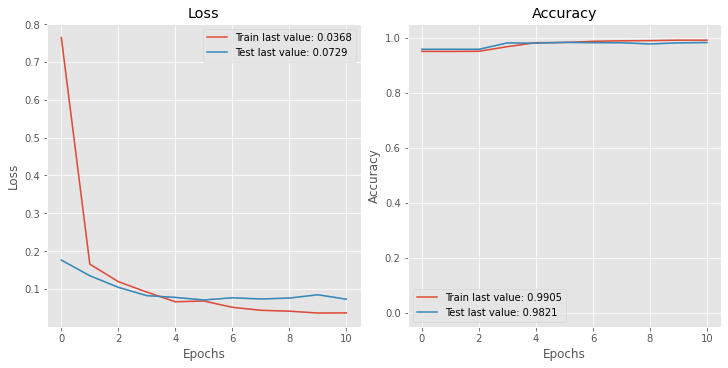

In [97]:
# Plot the graphs
plt.style.use("ggplot")
plot_history(h.history)
plt.show()

### Reporting of Performance Metrics

In [98]:
# Use the model to predict
y_pred = lstm_clf.predict([nlp_test, meta_test])

# Convert to class predictions
y_pred = np.where(y_pred > 0.5, 1, 0)

class_labels = ['Real', 'Fraud']

print('Confusion Matrix')
conf_lstm = confusion_matrix(y_test, y_pred)
print(conf_lstm)
print('\n')

print('Classification Report')
print(classification_report(y_test, y_pred, target_names=class_labels, digits=4))

Confusion Matrix
[[3362   17]
 [  47  103]]


Classification Report
              precision    recall  f1-score   support

        Real     0.9862    0.9950    0.9906      3379
       Fraud     0.8583    0.6867    0.7630       150

    accuracy                         0.9819      3529
   macro avg     0.9223    0.8408    0.8768      3529
weighted avg     0.9808    0.9819    0.9809      3529



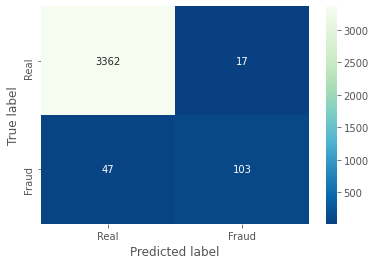

In [99]:
ax = sns.heatmap(conf_lstm, annot=True, fmt="d", cmap="GnBu_r")
ax.set_xticklabels(['Real', 'Fraud'])
ax.set_yticklabels(['Real', 'Fraud'])
plt.xlabel("Predicted label")
plt.ylabel("True label")
plt.show()

## Stage 2: Mixed data with Random Oversampling

### Sample the data after stratified split

In [100]:
# Perform the train test stratified split
X_train_over, X_test_over, y_train_over, y_test_over = train_test_split(X, df_text['fraudulent'], 
                                                                        test_size=0.2, random_state=123)

# Oversampling
oversample = RandomOverSampler(sampling_strategy=0.6667, random_state=123)

# Transform the data
X_train_over, y_train_over = oversample.fit_resample(X_train_over, y_train_over)

# View the target distribution
y_train_over.value_counts()

0    13408
1     8939
Name: fraudulent, dtype: int64

In [103]:
# From the splitted data, split again into nlp and meta train and test data
meta_train_over = X_train_over.drop(columns='lemmatized_body_text').values
text_train_over = X_train_over['lemmatized_body_text'].values
meta_test_over = X_test_over.drop(columns='lemmatized_body_text').values
text_test_over = X_test_over['lemmatized_body_text'].values

In [104]:
# Encode the target
le = LabelEncoder()
le.fit(y_train_over)
y_train_over = le.transform(y_train_over)
y_test_over = le.transform(y_test_over)

In [105]:
# Check the data types
type(y_train_over), type(y_test_over)

(numpy.ndarray, numpy.ndarray)

### Prepare the data into format for keras LSTM neural network

The same process is repeated for this stage to prepare the data before we can build the neural network structure.

In [106]:
# Setting the max size of the vocabulary
tokenizer = Tokenizer(num_words=5000)
tokenizer.fit_on_texts(text_train_over)

# Transform and create train and test for X
nlp_train_over = tokenizer.texts_to_sequences(text_train_over)
nlp_test_over = tokenizer.texts_to_sequences(text_test_over)

# Define the vocab size from the length of tokenizer index
vocab_size = len(tokenizer.word_index) + 1

In [107]:
# View the nlp train data
nlp_train_over

[[2973,
  519,
  8,
  1244,
  886,
  194,
  752,
  290,
  3238,
  59,
  1714,
  5,
  50,
  117,
  39,
  192,
  6,
  243,
  166,
  2,
  89,
  837,
  943,
  228,
  31,
  546,
  1172,
  2811,
  1492,
  78,
  1882,
  3435,
  823,
  731,
  1172,
  1848,
  155,
  175,
  29,
  19,
  221,
  11,
  373,
  1444,
  56,
  2597,
  179,
  90,
  300,
  9,
  62,
  2,
  1592,
  581,
  2737,
  29,
  1365,
  67,
  442,
  25,
  51,
  79,
  1916,
  166,
  449,
  892,
  7,
  62,
  102,
  56,
  1218,
  180,
  1656,
  180,
  175,
  536,
  56,
  856,
  1798,
  47,
  1294,
  658,
  593,
  843,
  1395,
  22,
  3104,
  51,
  19,
  1068,
  162,
  2714,
  4874,
  4244,
  1381,
  2635,
  226,
  4845,
  897,
  976,
  70,
  70,
  2,
  294,
  976,
  17,
  829],
 [193,
  698,
  753,
  8,
  2556,
  48,
  698,
  83,
  505,
  692,
  18,
  753,
  497,
  1376,
  83,
  114,
  232,
  244,
  18,
  1262,
  1500,
  448,
  201,
  980,
  1292,
  394,
  621,
  1876,
  1550,
  1542,
  58,
  419,
  715,
  356,
  652,
  1678,
  1735,
  

In [108]:
# View the nlp test data
nlp_test_over

[[712,
  115,
  284,
  8,
  1128,
  3602,
  206,
  917,
  4,
  1018,
  2238,
  296,
  778,
  379,
  54,
  787,
  44,
  2374,
  54,
  4,
  4018,
  712,
  400,
  494,
  3506,
  401,
  617,
  200,
  174,
  611,
  11,
  689,
  175,
  74,
  549,
  3142,
  1231,
  299,
  2643,
  1479,
  2454,
  244,
  958,
  333,
  70,
  1081,
  120,
  917,
  142,
  589,
  186,
  7,
  60,
  4,
  2617,
  712,
  39,
  420,
  125,
  108,
  546,
  1135,
  1,
  546,
  238,
  413,
  4233,
  308,
  3775,
  4187,
  1150,
  206,
  917,
  4,
  3553,
  403,
  53,
  184,
  3554,
  184,
  4,
  73,
  734,
  231,
  222,
  41,
  651,
  1109,
  917,
  4,
  415,
  242,
  251,
  158,
  43,
  1441,
  206,
  917,
  4,
  877,
  50,
  4,
  712,
  6,
  1757,
  3814,
  2341,
  377,
  1357,
  1485,
  206,
  917,
  4,
  1018,
  2238,
  296,
  778,
  379,
  54,
  787,
  44,
  2374,
  54,
  4,
  4018,
  712,
  400,
  494,
  3506,
  401,
  617,
  200,
  174,
  11,
  611,
  689,
  44,
  299,
  2643,
  1479,
  2454,
  958,
  333,
  70,
  1

In [109]:
type(nlp_train_over), type(nlp_test_over)

(list, list)

In [110]:
# Compare before and after transformation
print(text_train_over[0])
print(nlp_train_over[0])

red prairie consultant u va richmond duration month rate open inclusive responsibility us skill full understanding industry practice company policy procedure work problem diverse scope analysis data requires evaluation identifiable factor demonstrates good judgment selecting method technique evaluation criterion obtaining result assist design development maintenance client supply chain application accomplish partner operation understand business requirement work sr analyst teammate design coding one functional subset system software develop utility procedure documentation upon customer requirement maintain application release control version control assist supporting application installation upgrade including third party integration hardware configuration working varying software development deployment package radio frequency terminal specialty printer would receives little instruction day day work general instruction new assignment
[2973, 519, 8, 1244, 886, 194, 752, 290, 3238, 59, 17

In [111]:
# Explore the index of random words in the word_index dict
for word in ['experience', 'work', 'development', 'money']:
    print('{}: {}'.format(word, tokenizer.word_index[word]))

experience: 1
work: 2
development: 19
money: 435


In [112]:
# Setting the max length to be padded
maxlen = 150

# Padding the data
nlp_train_over = pad_sequences(nlp_train_over, padding='post', maxlen=maxlen)
nlp_test_over = pad_sequences(nlp_test_over, padding='post', maxlen=maxlen)

# View the padded train data
nlp_train_over[0, :]

array([2973,  519,    8, 1244,  886,  194,  752,  290, 3238,   59, 1714,
          5,   50,  117,   39,  192,    6,  243,  166,    2,   89,  837,
        943,  228,   31,  546, 1172, 2811, 1492,   78, 1882, 3435,  823,
        731, 1172, 1848,  155,  175,   29,   19,  221,   11,  373, 1444,
         56, 2597,  179,   90,  300,    9,   62,    2, 1592,  581, 2737,
         29, 1365,   67,  442,   25,   51,   79, 1916,  166,  449,  892,
          7,   62,  102,   56, 1218,  180, 1656,  180,  175,  536,   56,
        856, 1798,   47, 1294,  658,  593,  843, 1395,   22, 3104,   51,
         19, 1068,  162, 2714, 4874, 4244, 1381, 2635,  226, 4845,  897,
        976,   70,   70,    2,  294,  976,   17,  829,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0])

In [114]:
len(nlp_train_over), len(nlp_test_over), len(meta_train_over), len(meta_test_over)

(22347, 3529, 22347, 3529)

In [115]:
# Sequence length?
len(nlp_train_over[0]), len(nlp_test_over[0])

(150, 150)

### Define the structure of LSTM model

In [116]:
# Set up the parameter values
embedding_dim = 100
vocab_size = len(tokenizer.word_index) + 1
maxlen = 150
meta_input_dim = pd.get_dummies(df_structured.drop(columns='fraudulent')).shape[1]
epochs = 20
batch_size = 128

In [117]:
# Define the LSTM model
nlp_input = Input(shape=(maxlen,), name='nlp_input') 
meta_input = Input(shape=(meta_input_dim,), name='meta_input')
emb = Embedding(input_dim = vocab_size, output_dim = embedding_dim, input_length = maxlen)(nlp_input)

# We only use L2 regularizer for kernel that reduces input weights, more suitable than L1 to reduce overfitting
nlp_output = Bidirectional(LSTM(128, dropout=0.3, recurrent_dropout=0.3, kernel_regularizer=l2(0.01)))(emb)

# Combine both inputs to one layer
x = concatenate([nlp_output, meta_input])

# Add Global max pooling that outputs max value of the pool features, generally used in NLP
#x = GlobalMaxPool1D()(x)
x = Dense(32, activation='relu')(x)

# Output layer
x = Dense(1, activation='sigmoid')(x)

lstm_over = Model(inputs=[nlp_input, meta_input], outputs=[x])
lstm_over.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [118]:
# Model summary
lstm_over.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
nlp_input (InputLayer)          [(None, 150)]        0                                            
__________________________________________________________________________________________________
embedding_4 (Embedding)         (None, 150, 100)     3887200     nlp_input[0][0]                  
__________________________________________________________________________________________________
bidirectional_4 (Bidirectional) (None, 256)          234496      embedding_4[0][0]                
__________________________________________________________________________________________________
meta_input (InputLayer)         [(None, 162)]        0                                            
____________________________________________________________________________________________

### Model Training

In [119]:
# Show the current datetime
now = datetime.datetime.now()
print("Current date and time : ")
print(now.strftime("%Y-%m-%d %H:%M:%S"))

# Define early stopping, if 5 times no improvements then stop
es = EarlyStopping(monitor='val_loss', min_delta=0.0001, patience=5)

# Train the oversampled LSTM model
h_over = lstm_over.fit(x = [nlp_train_over, meta_train_over], 
                       y = y_train_over, 
                       steps_per_epoch = len(nlp_train_over) // batch_size,
                       batch_size=batch_size, 
                       epochs=epochs, 
                       validation_data = ([nlp_test_over, meta_test_over], y_test_over), 
                       validation_steps = len(nlp_test_over) // batch_size,
                       callbacks=[es], 
                       verbose=1)

Current date and time : 
2021-07-18 01:39:09
Epoch 1/20
174/174 [==============================] - 482s 3s/step - loss: 1.7969 - accuracy: 0.8037 - val_loss: 0.0994 - val_accuracy: 0.9754
Epoch 2/20
174/174 [==============================] - 475s 3s/step - loss: 0.0638 - accuracy: 0.9888 - val_loss: 0.0708 - val_accuracy: 0.9835
Epoch 3/20
174/174 [==============================] - 495s 3s/step - loss: 0.0307 - accuracy: 0.9963 - val_loss: 0.0810 - val_accuracy: 0.9826
Epoch 4/20
174/174 [==============================] - 481s 3s/step - loss: 0.0216 - accuracy: 0.9975 - val_loss: 0.0602 - val_accuracy: 0.9835
Epoch 5/20
174/174 [==============================] - 476s 3s/step - loss: 0.0174 - accuracy: 0.9984 - val_loss: 0.0673 - val_accuracy: 0.9852
Epoch 6/20
174/174 [==============================] - 484s 3s/step - loss: 0.0104 - accuracy: 0.9992 - val_loss: 0.0674 - val_accuracy: 0.9835
Epoch 7/20
174/174 [==============================] - 482s 3s/step - loss: 0.0130 - accuracy: 0.9

In [120]:
# Output the accuracies
train_loss_over, train_accuracy_over = lstm_over.evaluate([nlp_train_over, meta_train_over], y_train_over, verbose=False)
print("Training Accuracy: {:.4f}".format(train_accuracy_over))

test_loss_over, test_accuracy_over = lstm_over.evaluate([nlp_test_over, meta_test_over], y_test_over, verbose=False)
print("Testing Accuracy:  {:.4f}".format(test_accuracy_over))

Training Accuracy: 1.0000
Testing Accuracy:  0.9847


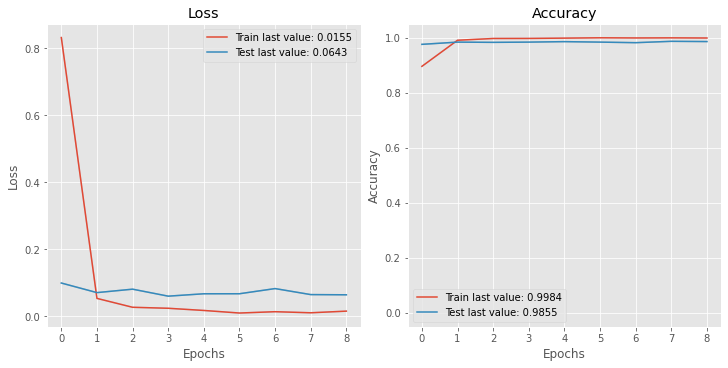

In [122]:
# Plot the graphs
plt.style.use("ggplot")
plot_history(h_over.history)
plt.show()

### Reporting of Performance Metrics

In [123]:
# Use the model to predict
y_pred = lstm_over.predict([nlp_test_over, meta_test_over])

# Convert to class predictions
y_pred = np.where(y_pred > 0.5, 1, 0)

class_labels = ['Real', 'Fraud']

print('Confusion Matrix')
conf_lstm_over = confusion_matrix(y_test_over, y_pred)
print(conf_lstm_over)
print('\n')

print('Classification Report')
print(classification_report(y_test_over, y_pred, target_names=class_labels, digits=4))

Confusion Matrix
[[3350   29]
 [  25  125]]


Classification Report
              precision    recall  f1-score   support

        Real     0.9926    0.9914    0.9920      3379
       Fraud     0.8117    0.8333    0.8224       150

    accuracy                         0.9847      3529
   macro avg     0.9021    0.9124    0.9072      3529
weighted avg     0.9849    0.9847    0.9848      3529



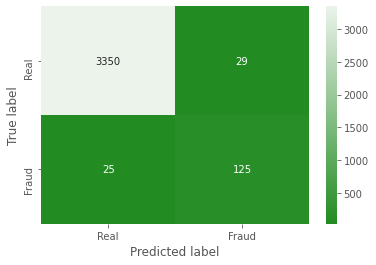

In [127]:
ax = sns.heatmap(conf_lstm_over, annot=True, fmt="d", cmap=sns.light_palette("forestgreen", as_cmap=True, reverse=True))
ax.set_xticklabels(['Real', 'Fraud'])
ax.set_yticklabels(['Real', 'Fraud'])
plt.xlabel("Predicted label")
plt.ylabel("True label")
plt.show()

## Stage 3: Mixed data with SMOTE sampling

In [128]:
# Perform the train test stratified split
X_train_smote, X_test_smote, y_train_smote, y_test_smote = train_test_split(X, df_text['fraudulent'], 
                                                                            test_size=0.2, random_state=123)

# Oversampling
smote = SMOTE(sampling_strategy=0.6667, random_state=123)

# Transform the data
X_train_smote, y_train_smote = oversample.fit_resample(X_train_smote, y_train_smote)

# View the target distribution
y_train_smote.value_counts()

0    13408
1     8939
Name: fraudulent, dtype: int64

In [129]:
# From the splitted data, split again into nlp and meta train and test data
meta_train_smote = X_train_smote.drop(columns='lemmatized_body_text').values
text_train_smote = X_train_smote['lemmatized_body_text'].values
meta_test_smote = X_test_smote.drop(columns='lemmatized_body_text').values
text_test_smote = X_test_smote['lemmatized_body_text'].values

In [130]:
# Encode the target
le = LabelEncoder()
le.fit(y_train_smote)
y_train_smote = le.transform(y_train_smote)
y_test_smote = le.transform(y_test_smote)

In [131]:
# Check the data types
type(y_train_smote), type(y_test_smote)

(numpy.ndarray, numpy.ndarray)

### Prepare the data into format for keras LSTM neural network

In [132]:
# Setting the max size of the vocabulary
tokenizer = Tokenizer(num_words=5000)
tokenizer.fit_on_texts(text_train_smote)

# Transform and create train and test for X
nlp_train_smote = tokenizer.texts_to_sequences(text_train_smote)
nlp_test_smote = tokenizer.texts_to_sequences(text_test_smote)

# Define the vocab size from the length of tokenizer index
vocab_size = len(tokenizer.word_index) + 1

In [133]:
# View the nlp train data
nlp_train_smote

[[2973,
  519,
  8,
  1244,
  886,
  194,
  752,
  290,
  3238,
  59,
  1714,
  5,
  50,
  117,
  39,
  192,
  6,
  243,
  166,
  2,
  89,
  837,
  943,
  228,
  31,
  546,
  1172,
  2811,
  1492,
  78,
  1882,
  3435,
  823,
  731,
  1172,
  1848,
  155,
  175,
  29,
  19,
  221,
  11,
  373,
  1444,
  56,
  2597,
  179,
  90,
  300,
  9,
  62,
  2,
  1592,
  581,
  2737,
  29,
  1365,
  67,
  442,
  25,
  51,
  79,
  1916,
  166,
  449,
  892,
  7,
  62,
  102,
  56,
  1218,
  180,
  1656,
  180,
  175,
  536,
  56,
  856,
  1798,
  47,
  1294,
  658,
  593,
  843,
  1395,
  22,
  3104,
  51,
  19,
  1068,
  162,
  2714,
  4874,
  4244,
  1381,
  2635,
  226,
  4845,
  897,
  976,
  70,
  70,
  2,
  294,
  976,
  17,
  829],
 [193,
  698,
  753,
  8,
  2556,
  48,
  698,
  83,
  505,
  692,
  18,
  753,
  497,
  1376,
  83,
  114,
  232,
  244,
  18,
  1262,
  1500,
  448,
  201,
  980,
  1292,
  394,
  621,
  1876,
  1550,
  1542,
  58,
  419,
  715,
  356,
  652,
  1678,
  1735,
  

In [134]:
# View the nlp test data
nlp_test_smote

[[712,
  115,
  284,
  8,
  1128,
  3602,
  206,
  917,
  4,
  1018,
  2238,
  296,
  778,
  379,
  54,
  787,
  44,
  2374,
  54,
  4,
  4018,
  712,
  400,
  494,
  3506,
  401,
  617,
  200,
  174,
  611,
  11,
  689,
  175,
  74,
  549,
  3142,
  1231,
  299,
  2643,
  1479,
  2454,
  244,
  958,
  333,
  70,
  1081,
  120,
  917,
  142,
  589,
  186,
  7,
  60,
  4,
  2617,
  712,
  39,
  420,
  125,
  108,
  546,
  1135,
  1,
  546,
  238,
  413,
  4233,
  308,
  3775,
  4187,
  1150,
  206,
  917,
  4,
  3553,
  403,
  53,
  184,
  3554,
  184,
  4,
  73,
  734,
  231,
  222,
  41,
  651,
  1109,
  917,
  4,
  415,
  242,
  251,
  158,
  43,
  1441,
  206,
  917,
  4,
  877,
  50,
  4,
  712,
  6,
  1757,
  3814,
  2341,
  377,
  1357,
  1485,
  206,
  917,
  4,
  1018,
  2238,
  296,
  778,
  379,
  54,
  787,
  44,
  2374,
  54,
  4,
  4018,
  712,
  400,
  494,
  3506,
  401,
  617,
  200,
  174,
  11,
  611,
  689,
  44,
  299,
  2643,
  1479,
  2454,
  958,
  333,
  70,
  1

In [135]:
type(nlp_train_smote), type(nlp_test_smote)

(list, list)

In [136]:
# Compare before and after transformation
print(text_train_smote[0])
print(nlp_train_smote[0])

red prairie consultant u va richmond duration month rate open inclusive responsibility us skill full understanding industry practice company policy procedure work problem diverse scope analysis data requires evaluation identifiable factor demonstrates good judgment selecting method technique evaluation criterion obtaining result assist design development maintenance client supply chain application accomplish partner operation understand business requirement work sr analyst teammate design coding one functional subset system software develop utility procedure documentation upon customer requirement maintain application release control version control assist supporting application installation upgrade including third party integration hardware configuration working varying software development deployment package radio frequency terminal specialty printer would receives little instruction day day work general instruction new assignment
[2973, 519, 8, 1244, 886, 194, 752, 290, 3238, 59, 17

In [137]:
# Explore the index of random words in the word_index dict
for word in ['experience', 'work', 'development', 'money']:
    print('{}: {}'.format(word, tokenizer.word_index[word]))

experience: 1
work: 2
development: 19
money: 435


In [138]:
# Setting the max length to be padded
maxlen = 150

# Padding the data
nlp_train_smote = pad_sequences(nlp_train_smote, padding='post', maxlen=maxlen)
nlp_test_smote = pad_sequences(nlp_test_smote, padding='post', maxlen=maxlen)

# View the padded train data
nlp_train_smote[0, :]

array([2973,  519,    8, 1244,  886,  194,  752,  290, 3238,   59, 1714,
          5,   50,  117,   39,  192,    6,  243,  166,    2,   89,  837,
        943,  228,   31,  546, 1172, 2811, 1492,   78, 1882, 3435,  823,
        731, 1172, 1848,  155,  175,   29,   19,  221,   11,  373, 1444,
         56, 2597,  179,   90,  300,    9,   62,    2, 1592,  581, 2737,
         29, 1365,   67,  442,   25,   51,   79, 1916,  166,  449,  892,
          7,   62,  102,   56, 1218,  180, 1656,  180,  175,  536,   56,
        856, 1798,   47, 1294,  658,  593,  843, 1395,   22, 3104,   51,
         19, 1068,  162, 2714, 4874, 4244, 1381, 2635,  226, 4845,  897,
        976,   70,   70,    2,  294,  976,   17,  829,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0])

In [139]:
len(nlp_train_smote), len(nlp_test_smote), len(meta_train_smote), len(meta_test_smote)

(22347, 3529, 22347, 3529)

In [140]:
# Sequence length?
len(nlp_train_smote[0]), len(nlp_test_smote[0])

(150, 150)

### Define the structure of LSTM model

In [141]:
# Set up the parameter values
embedding_dim = 100
vocab_size = len(tokenizer.word_index) + 1
maxlen = 150
meta_input_dim = pd.get_dummies(df_structured.drop(columns='fraudulent')).shape[1]
epochs = 20
batch_size = 128

In [142]:
# Define the LSTM model
nlp_input = Input(shape=(maxlen,), name='nlp_input') 
meta_input = Input(shape=(meta_input_dim,), name='meta_input')
emb = Embedding(input_dim = vocab_size, output_dim = embedding_dim, input_length = maxlen)(nlp_input)

# We only use L2 regularizer for kernel that reduces input weights, more suitable than L1 to reduce overfitting
nlp_output = Bidirectional(LSTM(128, dropout=0.3, recurrent_dropout=0.3, kernel_regularizer=l2(0.01)))(emb)

# Combine both inputs to one layer
x = concatenate([nlp_output, meta_input])

# Add Global max pooling that outputs max value of the pool features, generally used in NLP
#x = GlobalMaxPool1D()(x)
x = Dense(32, activation='relu')(x)

# Output layer
x = Dense(1, activation='sigmoid')(x)

lstm_smote = Model(inputs=[nlp_input, meta_input], outputs=[x])
lstm_smote.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [143]:
# Model summary
lstm_smote.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
nlp_input (InputLayer)          [(None, 150)]        0                                            
__________________________________________________________________________________________________
embedding_5 (Embedding)         (None, 150, 100)     3887200     nlp_input[0][0]                  
__________________________________________________________________________________________________
bidirectional_5 (Bidirectional) (None, 256)          234496      embedding_5[0][0]                
__________________________________________________________________________________________________
meta_input (InputLayer)         [(None, 162)]        0                                            
____________________________________________________________________________________________

### Model Training

In [144]:
# Show the current datetime
now = datetime.datetime.now()
print("Current date and time : ")
print(now.strftime("%Y-%m-%d %H:%M:%S"))

# Define early stopping, if 5 times no improvements then stop
es = EarlyStopping(monitor='val_loss', min_delta=0.0001, patience=5)

# Train the smote sampled LSTM model
h_smote = lstm_smote.fit(x = [nlp_train_smote, meta_train_smote], 
                         y = y_train_smote, 
                         steps_per_epoch = len(nlp_train_smote) // batch_size,
                         batch_size=batch_size, 
                         epochs=epochs, 
                         validation_data = ([nlp_test_smote, meta_test_smote], y_test_smote), 
                         validation_steps = len(nlp_test_smote) // batch_size,
                         callbacks=[es], 
                         verbose=1)

Current date and time : 
2021-07-18 04:02:40
Epoch 1/20
174/174 [==============================] - 506s 3s/step - loss: 1.7729 - accuracy: 0.7890 - val_loss: 0.0976 - val_accuracy: 0.9789
Epoch 2/20
174/174 [==============================] - 502s 3s/step - loss: 0.0720 - accuracy: 0.9861 - val_loss: 0.0960 - val_accuracy: 0.9740
Epoch 3/20
174/174 [==============================] - 485s 3s/step - loss: 0.0364 - accuracy: 0.9947 - val_loss: 0.1008 - val_accuracy: 0.9786
Epoch 4/20
174/174 [==============================] - 481s 3s/step - loss: 0.0286 - accuracy: 0.9963 - val_loss: 0.1066 - val_accuracy: 0.9751
Epoch 5/20
174/174 [==============================] - 476s 3s/step - loss: 0.0186 - accuracy: 0.9977 - val_loss: 0.0991 - val_accuracy: 0.9795
Epoch 6/20
174/174 [==============================] - 476s 3s/step - loss: 0.0145 - accuracy: 0.9979 - val_loss: 0.1170 - val_accuracy: 0.9769
Epoch 7/20
174/174 [==============================] - 477s 3s/step - loss: 0.0178 - accuracy: 0.9

In [146]:
# Output the accuracies
train_loss_smote, train_accuracy_smote = lstm_smote.evaluate([nlp_train_smote, meta_train_smote], y_train_smote, verbose=False)
print("Training Accuracy: {:.4f}".format(train_accuracy_smote))

test_loss_smote, test_accuracy_smote = lstm_smote.evaluate([nlp_test_smote, meta_test_smote], y_test_smote, verbose=False)
print("Testing Accuracy:  {:.4f}".format(test_accuracy_smote))

Training Accuracy: 0.9997
Testing Accuracy:  0.9785


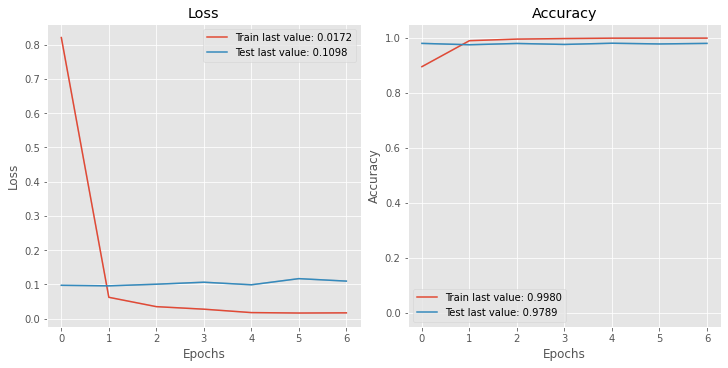

In [147]:
# Plot the graphs
plt.style.use("ggplot")
plot_history(h_smote.history)
plt.show()

### Reporting of Performance Metrics

In [148]:
# Use the model to predict
y_pred = lstm_smote.predict([nlp_test_smote, meta_test_smote])

# Convert to class predictions
y_pred = np.where(y_pred > 0.5, 1, 0)

class_labels = ['Real', 'Fraud']

print('Confusion Matrix')
conf_lstm_smote = confusion_matrix(y_test_smote, y_pred)
print(conf_lstm_smote)
print('\n')

print('Classification Report')
print(classification_report(y_test_smote, y_pred, target_names=class_labels, digits=4))

Confusion Matrix
[[3336   43]
 [  33  117]]


Classification Report
              precision    recall  f1-score   support

        Real     0.9902    0.9873    0.9887      3379
       Fraud     0.7312    0.7800    0.7548       150

    accuracy                         0.9785      3529
   macro avg     0.8607    0.8836    0.8718      3529
weighted avg     0.9792    0.9785    0.9788      3529



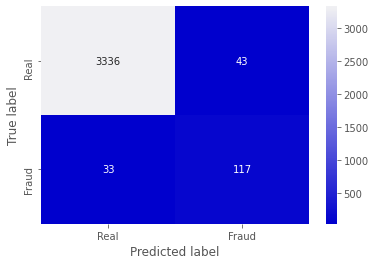

In [149]:
ax = sns.heatmap(conf_lstm_smote, annot=True, fmt="d", cmap=sns.light_palette("mediumblue", as_cmap=True, reverse=True))
ax.set_xticklabels(['Real', 'Fraud'])
ax.set_yticklabels(['Real', 'Fraud'])
plt.xlabel("Predicted label")
plt.ylabel("True label")
plt.show()

## Improving the best model (Oversampling)

### Tuning the batch size

We changed the batch size from 128 to 64, hoping that using a smaller batch size can slightly improve accuracy and even the fraud recall.

In [150]:
# Set up the parameter values
embedding_dim = 100
vocab_size = len(tokenizer.word_index) + 1
maxlen = 150
meta_input_dim = pd.get_dummies(df_structured.drop(columns='fraudulent')).shape[1]
epochs = 20
batch_size = 64

In [151]:
# Define the LSTM model
nlp_input = Input(shape=(maxlen,), name='nlp_input') 
meta_input = Input(shape=(meta_input_dim,), name='meta_input')
emb = Embedding(input_dim = vocab_size, output_dim = embedding_dim, input_length = maxlen)(nlp_input)

# We only use L2 regularizer for kernel that reduces input weights, more suitable than L1 to reduce overfitting
nlp_output = Bidirectional(LSTM(128, dropout=0.3, recurrent_dropout=0.3, kernel_regularizer=l2(0.01)))(emb)

# Combine both inputs to one layer
x = concatenate([nlp_output, meta_input])

# Add Global max pooling that outputs max value of the pool features, generally used in NLP
#x = GlobalMaxPool1D()(x)
x = Dense(32, activation='relu')(x)

# Output layer
x = Dense(1, activation='sigmoid')(x)

lstm_over_64 = Model(inputs=[nlp_input, meta_input], outputs=[x])
lstm_over_64.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [152]:
# Model summary
lstm_over_64.summary()

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
nlp_input (InputLayer)          [(None, 150)]        0                                            
__________________________________________________________________________________________________
embedding_6 (Embedding)         (None, 150, 100)     3887200     nlp_input[0][0]                  
__________________________________________________________________________________________________
bidirectional_6 (Bidirectional) (None, 256)          234496      embedding_6[0][0]                
__________________________________________________________________________________________________
meta_input (InputLayer)         [(None, 162)]        0                                            
____________________________________________________________________________________________

### Model Training

In [153]:
# Show the current datetime
now = datetime.datetime.now()
print("Current date and time : ")
print(now.strftime("%Y-%m-%d %H:%M:%S"))

# Define early stopping, if 5 times no improvements then stop
es = EarlyStopping(monitor='val_loss', min_delta=0.0001, patience=5)

# Train the oversampled LSTM model
h_over_64 = lstm_over_64.fit(x = [nlp_train_over, meta_train_over], 
                             y = y_train_over, 
                             steps_per_epoch = len(nlp_train_over) // batch_size,
                             batch_size=batch_size, 
                             epochs=epochs, 
                             validation_data = ([nlp_test_over, meta_test_over], y_test_over), 
                             validation_steps = len(nlp_test_over) // batch_size,
                             callbacks=[es], 
                             verbose=1)

Current date and time : 
2021-07-18 07:36:44
Epoch 1/20
349/349 [==============================] - 979s 3s/step - loss: 1.2516 - accuracy: 0.8188 - val_loss: 0.0894 - val_accuracy: 0.9793
Epoch 2/20
349/349 [==============================] - 960s 3s/step - loss: 0.0528 - accuracy: 0.9920 - val_loss: 0.0655 - val_accuracy: 0.9849
Epoch 3/20
349/349 [==============================] - 956s 3s/step - loss: 0.0248 - accuracy: 0.9970 - val_loss: 0.0620 - val_accuracy: 0.9855
Epoch 4/20
349/349 [==============================] - 953s 3s/step - loss: 0.0156 - accuracy: 0.9983 - val_loss: 0.0639 - val_accuracy: 0.9869
Epoch 5/20
349/349 [==============================] - 957s 3s/step - loss: 0.0127 - accuracy: 0.9988 - val_loss: 0.0702 - val_accuracy: 0.9835
Epoch 6/20
349/349 [==============================] - 958s 3s/step - loss: 0.0130 - accuracy: 0.9987 - val_loss: 0.0642 - val_accuracy: 0.9852
Epoch 7/20
349/349 [==============================] - 967s 3s/step - loss: 0.0122 - accuracy: 0.9

In [154]:
# Output the accuracies
train_loss_over_64, train_accuracy_over_64 = lstm_over_64.evaluate([nlp_train_over, meta_train_over], y_train_over, verbose=False)
print("Training Accuracy: {:.4f}".format(train_accuracy_over_64))

test_loss_over_64, test_accuracy_over_64 = lstm_over_64.evaluate([nlp_test_over, meta_test_over], y_test_over, verbose=False)
print("Testing Accuracy:  {:.4f}".format(test_accuracy_over_64))

Training Accuracy: 0.9984
Testing Accuracy:  0.9867


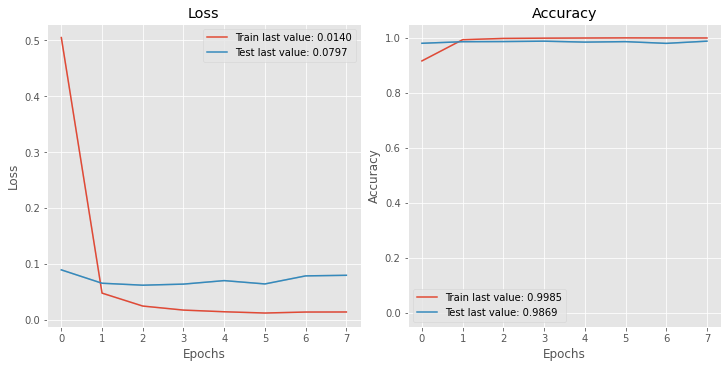

In [155]:
# Plot the graphs
plt.style.use("ggplot")
plot_history(h_over_64.history)
plt.show()

### Reporting of Performance Metrics

In [156]:
# Use the model to predict
y_pred = lstm_over_64.predict([nlp_test_over, meta_test_over])

# Convert to class predictions
y_pred = np.where(y_pred > 0.5, 1, 0)

class_labels = ['Real', 'Fraud']

print('Confusion Matrix')
conf_lstm_over_64 = confusion_matrix(y_test_over, y_pred)
print(conf_lstm_over_64)
print('\n')

print('Classification Report')
print(classification_report(y_test_over, y_pred, target_names=class_labels, digits=4))

Confusion Matrix
[[3370    9]
 [  38  112]]


Classification Report
              precision    recall  f1-score   support

        Real     0.9888    0.9973    0.9931      3379
       Fraud     0.9256    0.7467    0.8266       150

    accuracy                         0.9867      3529
   macro avg     0.9572    0.8720    0.9098      3529
weighted avg     0.9862    0.9867    0.9860      3529



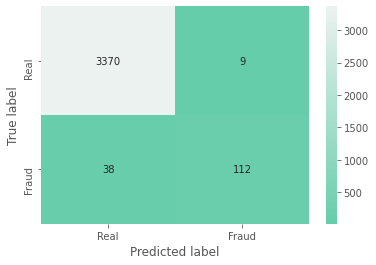

In [157]:
ax = sns.heatmap(conf_lstm_over_64, annot=True, fmt="d", cmap=sns.light_palette("mediumaquamarine", as_cmap=True, 
                                                                                reverse=True))
ax.set_xticklabels(['Real', 'Fraud'])
ax.set_yticklabels(['Real', 'Fraud'])
plt.xlabel("Predicted label")
plt.ylabel("True label")
plt.show()

Although the accuracy has increased a little, but we see a significant drop in recall of fraud class to just 0.7467 which is bad. Thus, this is not entirely the best performing model among the 4 models.

### Conclusion on LSTM modeling

The model with the best overall accuracy is the LSTM model trained with **random oversampling** with the **batch size tuned to value of 64**, with the accuracy of **0.9867**. As for recall for fraud class, the best model goes to the LSTM model trained with **random oversampling** with the initial **batch size of 128**, obtaining a recall of **0.8333**.

## Saving the best performing LSTM model

We'll save 2 models, one with the best accuracy and another one with the best fraud recall just to be safe.

In [158]:
lstm_over

In [159]:
lstm_over_64

In [160]:
# Save batch 128 model and architecture to single h5 file
lstm_over.save("RS_lstm_over_128_18072021.h5")

# Save batch 64 model and architecture to single h5 file
lstm_over_64.save("RS_lstm_over_64_18072021.h5")

Let's test and see if we can load the model without problems.

In [163]:
model_test = load_model('RS_lstm_over_128_18072021.h5')
model_test.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
nlp_input (InputLayer)          [(None, 150)]        0                                            
__________________________________________________________________________________________________
embedding_4 (Embedding)         (None, 150, 100)     3887200     nlp_input[0][0]                  
__________________________________________________________________________________________________
bidirectional_4 (Bidirectional) (None, 256)          234496      embedding_4[0][0]                
__________________________________________________________________________________________________
meta_input (InputLayer)         [(None, 162)]        0                                            
____________________________________________________________________________________________

Nice, it can be loaded well with summary function working as expected! We can end the machine learning stage now.